### Customer Churn Analysis for a Telecom Company

In [2]:
# Import necessary libraries

# For Data Analysis
import pandas as pd
import numpy as np
from time import strptime

# For Data Visualisation
import matplotlib.pyplot as plt
import seaborn as sns

# Data Preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold
from sklearn.preprocessing import MinMaxScaler
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline as imbpipeline
from sklearn.pipeline import Pipeline
from sklearn.datasets import make_classification, load_breast_cancer
from sklearn.preprocessing import RobustScaler

In [3]:
# Bring in the dataset and display the first 5 rows
df = pd.read_excel(r"C:\Users\HENRY OKEOMA\Desktop\Customer Churn Project\Dataset.xlsx")
df.head(5)

,CustomerID,Name,Age,Gender,Location,Email,Phone,Address,Segment,PurchaseHistory,...,ServiceInteractions,PaymentHistory,WebsiteUsage,ClickstreamData,EngagementMetrics,Feedback,MarketingCommunication,NPS,ChurnLabel,Timestamp
0,1001,Mark Barrett,31,Male,Andrewfort,allison74@example.net,3192528777,"61234 Shelley Heights Suite 467\nCohentown, GU...",Segment B,"[{'Product': 'Frozen Cocktail Mixes', 'Frequen...",...,"[{'Type': 'Call', 'Date': '2019-09-26'}, {'Typ...","[{'Method': 'Credit Card', 'Late_Payments': 5}...","{'PageViews': 49, 'TimeSpent(minutes)': 15}","[{'Action': 'Add to Cart', 'Page': 'register',...","{'Logins': 19, 'Frequency': 'Weekly'}","{'Rating': 1, 'Comment': 'I move baby go small...","[{'Email_Sent': '2019-10-17', 'Email_Opened': ...",3,1,2020-01-27 01:36:49
1,1002,Jeremy Welch,66,Female,Millerhaven,fmiller@example.com,231-587-1818x8651,"4959 Jennifer Junction\nNew Angelaport, TN 87397",Segment C,"[{'Product': 'Watercraft Polishes', 'Frequency...",...,"[{'Type': 'Call', 'Date': '2020-01-05'}, {'Typ...","[{'Method': 'Credit Card', 'Late_Payments': 3}...","{'PageViews': 100, 'TimeSpent(minutes)': 9}","[{'Action': 'Add to Cart', 'Page': 'homepage',...","{'Logins': 9, 'Frequency': 'Weekly'}","{'Rating': 2, 'Comment': 'Wish what bag cut li...","[{'Email_Sent': '2021-08-02', 'Email_Opened': ...",6,0,2019-01-06 18:30:03
2,1003,Brandon Patel,36,Female,Lozanostad,jasonbrown@example.org,(270)633-9095,"38701 Amanda Brook Apt. 076\nKimshire, NJ 62516",Segment B,"[{'Product': 'Vehicle Waxes, Polishes & Protec...",...,"[{'Type': 'Email', 'Date': '2019-10-09'}, {'Ty...","[{'Method': 'Credit Card', 'Late_Payments': 1}...","{'PageViews': 1, 'TimeSpent(minutes)': 97}","[{'Action': 'Search', 'Page': 'terms', 'Timest...","{'Logins': 19, 'Frequency': 'Monthly'}","{'Rating': 4, 'Comment': 'Some Democrat guess ...","[{'Email_Sent': '2021-08-29', 'Email_Opened': ...",3,0,2019-04-30 04:25:10
3,1004,Tina Martin,62,Female,South Dustin,matthew62@example.net,050.081.8706x11982,"67324 Ashley Coves\nSouth John, RI 29650",Segment C,"[{'Product': 'Mouthwash', 'Frequency': 5, 'Val...",...,"[{'Type': 'Call', 'Date': '2020-08-28'}, {'Typ...","[{'Method': 'Credit Card', 'Late_Payments': 36...","{'PageViews': 25, 'TimeSpent(minutes)': 31}","[{'Action': 'Click', 'Page': 'privacy', 'Times...","{'Logins': 4, 'Frequency': 'Daily'}","{'Rating': 1, 'Comment': 'Yard feel never miss...","[{'Email_Sent': '2021-02-03', 'Email_Opened': ...",1,1,2020-03-03 17:33:28
4,1005,Christopher Rodriguez,68,Female,West James,shannonstrickland@example.org,+1-701-854-4915x724,"01169 Miller Mission\nWest Anthonyburgh, WY 47359",Segment C,"[{'Product': 'Ice Cream Novelties', 'Frequency...",...,"[{'Type': 'Call', 'Date': '2019-04-10'}, {'Typ...","[{'Method': 'Credit Card', 'Late_Payments': 0}...","{'PageViews': 77, 'TimeSpent(minutes)': 51}","[{'Action': 'Click', 'Page': 'privacy', 'Times...","{'Logins': 12, 'Frequency': 'Weekly'}","{'Rating': 3, 'Comment': 'Ten determine unit i...","[{'Email_Sent': '2022-03-11', 'Email_Opened': ...",3,0,2019-04-05 22:42:22


In [4]:
# Check missing values
df.isnull().sum()

CustomerID                0
Name                      0
Age                       0
Gender                    0
Location                  0
Email                     0
Phone                     0
Address                   0
Segment                   0
PurchaseHistory           0
SubscriptionDetails       0
ServiceInteractions       0
PaymentHistory            0
WebsiteUsage              0
ClickstreamData           0
EngagementMetrics         0
Feedback                  0
MarketingCommunication    0
NPS                       0
ChurnLabel                0
Timestamp                 0
dtype: int64

#### We have no missing values innour data

In [5]:
# Check for duplicates values
df.duplicated().any()

False

In [6]:
# Data Description (Statistical analysis)
df.describe().round(2)

,CustomerID,Age,NPS,ChurnLabel
count,12483.00,12483.00,12483.00,12483.00
mean,7242.00,43.93,2.97,0.51
std,3603.68,15.34,2.64,0.50
min,1001.00,18.00,0.00,0.00
25%,4121.50,31.00,1.00,0.00
50%,7242.00,44.00,2.00,1.00
75%,10362.50,57.00,4.00,1.00
max,13483.00,70.00,9.00,1.00


In [7]:
# Check data for more understanding data types
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12483 entries, 0 to 12482
Data columns (total 21 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   CustomerID              12483 non-null  int64 
 1   Name                    12483 non-null  object
 2   Age                     12483 non-null  int64 
 3   Gender                  12483 non-null  object
 4   Location                12483 non-null  object
 5   Email                   12483 non-null  object
 6   Phone                   12483 non-null  object
 7   Address                 12483 non-null  object
 8   Segment                 12483 non-null  object
 9   PurchaseHistory         12483 non-null  object
 10  SubscriptionDetails     12483 non-null  object
 11  ServiceInteractions     12483 non-null  object
 12  PaymentHistory          12483 non-null  object
 13  WebsiteUsage            12483 non-null  object
 14  ClickstreamData         12483 non-null  object
 15  En

In [8]:
# We have the time stamp as object, we shall convert this to date time
df['Timestamp'] = pd.to_datetime(df['Timestamp'])

In [9]:
# Lets extract Year, Month, year Day of week and Quater from the Timestamp.
df['Year'] = df['Timestamp'].dt.year
df['Month'] = df['Timestamp'].dt.month
df['Month_name'] = df['Timestamp'].dt.month_name()
df['Day_name'] = df['Timestamp'].dt.day_name()
df['Quarter'] = df['Timestamp'].dt.quarter


df.head(2)

,CustomerID,Name,Age,Gender,Location,Email,Phone,Address,Segment,PurchaseHistory,...,Feedback,MarketingCommunication,NPS,ChurnLabel,Timestamp,Year,Month,Month_name,Day_name,Quarter
0,1001,Mark Barrett,31,Male,Andrewfort,allison74@example.net,3192528777,"61234 Shelley Heights Suite 467\nCohentown, GU...",Segment B,"[{'Product': 'Frozen Cocktail Mixes', 'Frequen...",...,"{'Rating': 1, 'Comment': 'I move baby go small...","[{'Email_Sent': '2019-10-17', 'Email_Opened': ...",3,1,2020-01-27 01:36:49,2020,1,January,Monday,1
1,1002,Jeremy Welch,66,Female,Millerhaven,fmiller@example.com,231-587-1818x8651,"4959 Jennifer Junction\nNew Angelaport, TN 87397",Segment C,"[{'Product': 'Watercraft Polishes', 'Frequency...",...,"{'Rating': 2, 'Comment': 'Wish what bag cut li...","[{'Email_Sent': '2021-08-02', 'Email_Opened': ...",6,0,2019-01-06 18:30:03,2019,1,January,Sunday,1


In [10]:
# Also lets create another another Function and a Column to define season
def Season(x):
    if x == 'March':
        return 'Spring'
    elif x == 'April':
        return 'Spring'
    elif x == 'April':
        return 'Spring'
    elif x == 'May':
        return 'Spring'
    elif x ==  'June':
        return 'Summer'
    elif x ==  'July':
        return 'Summer'
    elif x ==  'August':
        return 'Summer'
    elif x == 'September':
        return 'Autumn'
    elif x == 'October':
        return 'Autumn' 
    elif x == 'November':
        return 'Autumn'
    elif x == 'December':
        return 'Winter'
    elif x == 'January':
        return 'Winter'
    elif x == 'February':
        return 'Winter'

df['Season'] = df['Month_name'].apply(Season)
df.head(3)

,CustomerID,Name,Age,Gender,Location,Email,Phone,Address,Segment,PurchaseHistory,...,MarketingCommunication,NPS,ChurnLabel,Timestamp,Year,Month,Month_name,Day_name,Quarter,Season
0,1001,Mark Barrett,31,Male,Andrewfort,allison74@example.net,3192528777,"61234 Shelley Heights Suite 467\nCohentown, GU...",Segment B,"[{'Product': 'Frozen Cocktail Mixes', 'Frequen...",...,"[{'Email_Sent': '2019-10-17', 'Email_Opened': ...",3,1,2020-01-27 01:36:49,2020,1,January,Monday,1,Winter
1,1002,Jeremy Welch,66,Female,Millerhaven,fmiller@example.com,231-587-1818x8651,"4959 Jennifer Junction\nNew Angelaport, TN 87397",Segment C,"[{'Product': 'Watercraft Polishes', 'Frequency...",...,"[{'Email_Sent': '2021-08-02', 'Email_Opened': ...",6,0,2019-01-06 18:30:03,2019,1,January,Sunday,1,Winter
2,1003,Brandon Patel,36,Female,Lozanostad,jasonbrown@example.org,(270)633-9095,"38701 Amanda Brook Apt. 076\nKimshire, NJ 62516",Segment B,"[{'Product': 'Vehicle Waxes, Polishes & Protec...",...,"[{'Email_Sent': '2021-08-29', 'Email_Opened': ...",3,0,2019-04-30 04:25:10,2019,4,April,Tuesday,2,Spring


In [11]:
# Lets put the ages of the Customers into bucket, knowing the range as 18 - 70

# Age Brackets

def age_bracket(Age):
    if Age <= 35:
        return 'Youth(<35)'
    elif Age <= 55:
        return 'Adult(<=55)'
    elif Age <= 65:
        return 'Old Adult(<=65)'
    else:
        return 'Elderly (>65)'

df['age_bracket'] = df['Age'].apply(age_bracket)
df.head(3)

,CustomerID,Name,Age,Gender,Location,Email,Phone,Address,Segment,PurchaseHistory,...,NPS,ChurnLabel,Timestamp,Year,Month,Month_name,Day_name,Quarter,Season,age_bracket
0,1001,Mark Barrett,31,Male,Andrewfort,allison74@example.net,3192528777,"61234 Shelley Heights Suite 467\nCohentown, GU...",Segment B,"[{'Product': 'Frozen Cocktail Mixes', 'Frequen...",...,3,1,2020-01-27 01:36:49,2020,1,January,Monday,1,Winter,Youth(<35)
1,1002,Jeremy Welch,66,Female,Millerhaven,fmiller@example.com,231-587-1818x8651,"4959 Jennifer Junction\nNew Angelaport, TN 87397",Segment C,"[{'Product': 'Watercraft Polishes', 'Frequency...",...,6,0,2019-01-06 18:30:03,2019,1,January,Sunday,1,Winter,Elderly (>65)
2,1003,Brandon Patel,36,Female,Lozanostad,jasonbrown@example.org,(270)633-9095,"38701 Amanda Brook Apt. 076\nKimshire, NJ 62516",Segment B,"[{'Product': 'Vehicle Waxes, Polishes & Protec...",...,3,0,2019-04-30 04:25:10,2019,4,April,Tuesday,2,Spring,Adult(<=55)


### Exploratory Data Analysis

#### We need to understand the data and with emphasis of churning

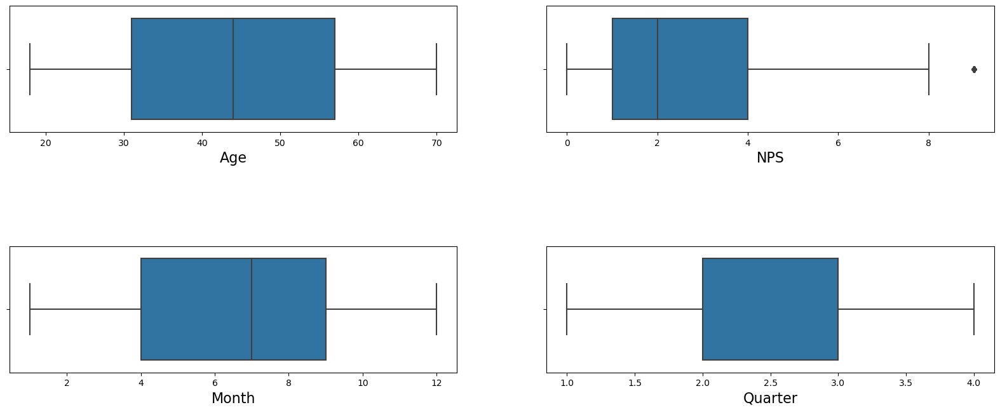

In [12]:
# We shall use the boxplot to visisualise all the numerical columns. This will enable us to point areas 
# we may find useful insights

import warnings

# Ignore all warnings
warnings.simplefilter("ignore")

fig, axs = plt.subplots(2,2, figsize = (20,7.5))
plt1 = sns.boxplot(df['Age'], ax = axs[0,0])
plt2 = sns.boxplot(df['NPS'], ax = axs[0,1])
plt3 = sns.boxplot(df['Month'], ax = axs[1,0])
plt4 = sns.boxplot(df['Quarter'], ax = axs[1,1])

# Increase the label font size
plt1.set_xlabel('Age', fontsize=16)
plt2.set_xlabel('NPS', fontsize=16)
plt3.set_xlabel('Month', fontsize=16)
plt4.set_xlabel('Quarter', fontsize=16)

  # Adjust the vertical spacing between subplots
plt.subplots_adjust(hspace=0.9)
plt.show()

#### The age of most our customers are between 31 & 57, with a positively skewed net promoter score. The month in our data is between April and sept where we have most data, which is synomymous to the second and third quater of the year.

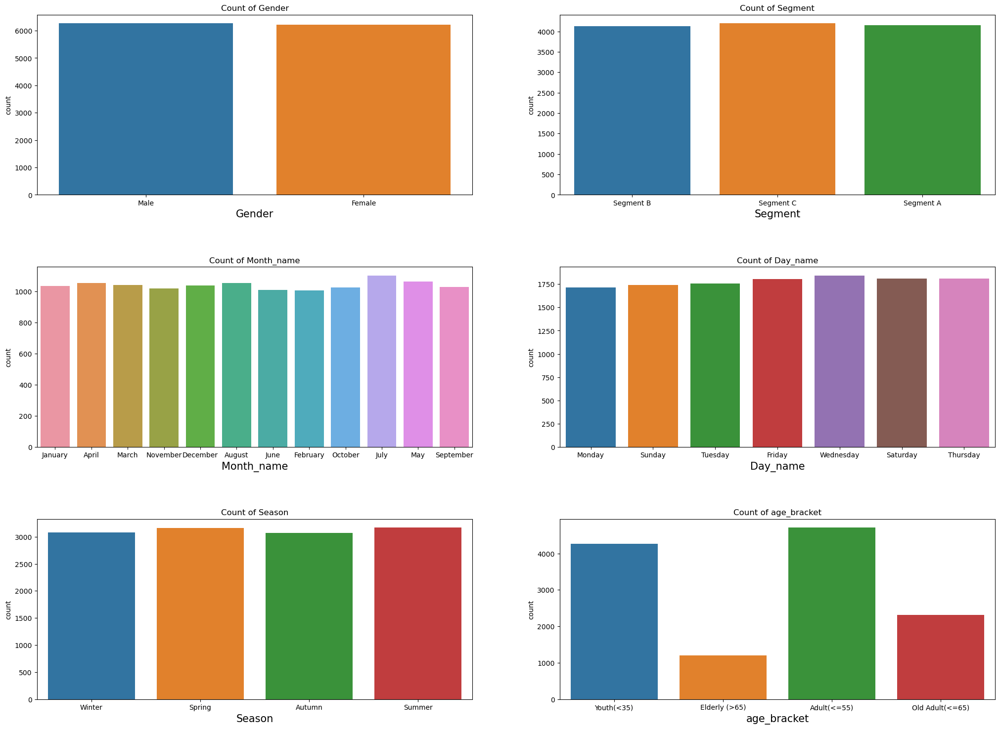

In [13]:
# We shall also visualise the categorical columns to see how they appearon our data.

#We shall use the Barplot to visualise the Categorical columns

fig, axs = plt.subplots(3,2, figsize = (25,18))

axs[0,0].set_title('Count of Gender')
plt1 = sns.countplot(x = df['Gender'], data=df, ax = axs[0,0])

axs[0,1].set_title('Count of Segment')
plt2 = sns.countplot(x= df['Segment'],data=df, ax = axs[0,1])


axs[1,0].set_title('Count of Month_name')
plt3 = sns.countplot(x = df['Month_name'], data=df, ax = axs[1,0])


axs[1,1].set_title('Count of Day_name')
plt4 = sns.countplot(x = df['Day_name'],data=df, ax = axs[1,1])

plt.title('Count of Season')
axs[2,0].set_title('Count of Season')
plt5 = sns.countplot(x= df['Season'],data=df, ax = axs[2,0])


axs[2,1].set_title('Count of age_bracket')
plt6 = sns.countplot(x = df['age_bracket'],data=df, ax = axs[2,1])

# Increase the label font size
plt1.set_xlabel('Gender', fontsize=15)
plt2.set_xlabel('Segment', fontsize=15)
plt3.set_xlabel('Month_name', fontsize=15)
plt4.set_xlabel('Day_name', fontsize=15)
plt5.set_xlabel('Season', fontsize=15)
plt6.set_xlabel('age_bracket', fontsize=15)

plt.subplots_adjust(hspace=0.4)  # Adjust the vertical spacing between subplots
plt.show()

#### We can see that in almost all the categorical columns, there is no significant difference between the variables except the age bracket which has most of customers in the category of youth and adults with few elderly and old adults

### Bivariate Analysis
- with emphasis on ChurnLabel

In [14]:
# Lets start with the gender. 
# Churn = 1
# No Churn = 0

gender_df = df.groupby('Gender')[['ChurnLabel']].sum().reset_index()
gender_df

,Gender,ChurnLabel
0,Female,3105
1,Male,3209


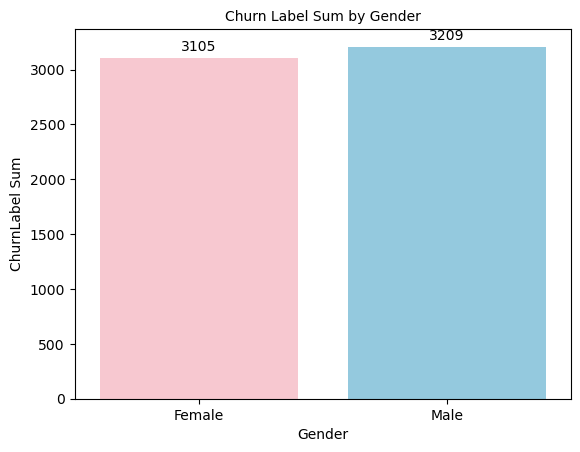

In [15]:
# We shall visualise the Total Sums from each category as below
# Plotting with Seaborn
ax = sns.barplot(x='Gender', y='ChurnLabel', data=gender_df, palette=['pink', 'skyblue'])

# Add numbers on top of the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 8),
                textcoords='offset points')

plt.title('Churn Label Sum by Gender', fontsize=10)
plt.xlabel('Gender')
plt.ylabel('ChurnLabel Sum')

# Display the plot
plt.show()

#### We have more of our male customers churning than female. Although the difference is not significant

In [16]:
# Churn By customer segment
segment_df = df.groupby('Segment')[['ChurnLabel']].sum().reset_index()
segment_df

,Segment,ChurnLabel
0,Segment A,2127
1,Segment B,2064
2,Segment C,2123


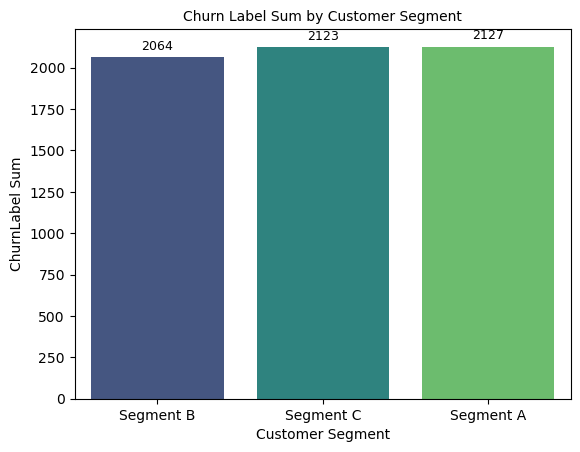

In [17]:
# Sort the DataFrame by 'ChurnLabel' in ascending order
segment_df = segment_df.sort_values(by='ChurnLabel')

# Plotting with Seaborn
ax = sns.barplot(x='Segment', y='ChurnLabel', data=segment_df, palette='viridis')

# Add numbers on top of the bars in ascending order
for p, value in zip(ax.patches, segment_df['ChurnLabel']):
    ax.annotate(f'{value:.0f}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=9, color='black', xytext=(0, 8),
                textcoords='offset points')

plt.title('Churn Label Sum by Customer Segment', fontsize=10)
plt.xlabel('Customer Segment')
plt.ylabel('ChurnLabel Sum')

# Display the plot
plt.show()

#### Segment B customers have the least number of churn, while segment A have the most churnned numbers

In [18]:
# Churn By Year
year_df = df.groupby('Year')[['ChurnLabel']].sum().reset_index()
year_df

,Year,ChurnLabel
0,2019,1599
1,2020,1635
2,2021,1525
3,2022,1555


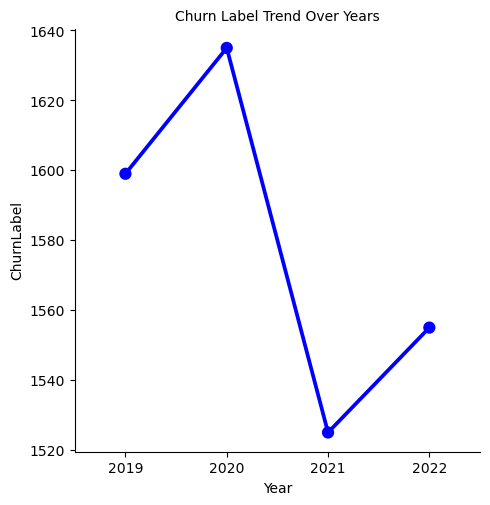

In [19]:
# Plotting with Seaborn
sns.factorplot(x='Year', y='ChurnLabel', data=year_df, marker='o', color='blue')

# Adding labels and title
plt.title('Churn Label Trend Over Years', fontsize=10)
plt.xlabel('Year')
plt.ylabel('ChurnLabel')

# Display the plot
plt.show()

#### The churning trend increased from 2019 to 2020 (this is the peak of churn), but then there was a sharp frop from 2020 to 2021; with another increase in churning in 2022. In 2019, there were 1599 instances of churn which increased slightly to 1635 in 2020; followed by a decrease to 1525 churn instances in 2021. This gain reversed to 1555 in 2022. Further analysis could involve exploring factors that might contribute to the changes in churn, such as changes in customer behavior, marketing strategies, or external factors affecting the industry.


In [20]:
# Chrnung By Month_name
month_df = df.groupby('Month')[['ChurnLabel']].sum().reset_index()
month_df

,Month,ChurnLabel
0,1,513
1,2,501
2,3,540
3,4,521
4,5,519
5,6,498
6,7,583
7,8,546
8,9,528
9,10,527


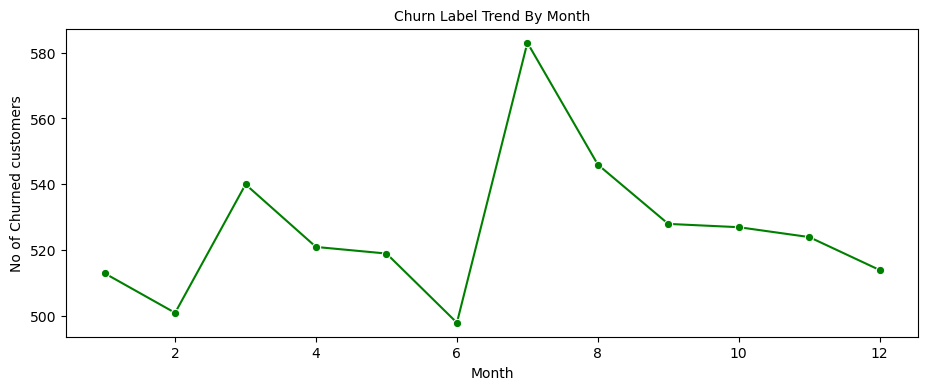

In [21]:
# Plotting with Seaborn lineplot
plt.figure(figsize=(11,4))
sns.lineplot(x='Month', y='ChurnLabel', data=month_df, marker='o', color='green')

# Adding labels and title
plt.title('Churn Label Trend By Month', fontsize=10)
plt.xlabel('Month')
plt.ylabel('No of Churned customers')

# Display the plot
plt.show()

#### Churn counts seem to hover around a relatively consistent range in most months, with values between 498 and 583. This consistency might suggest a stable customer base or predictable patterns in customer behavior. Peaks in churn (July) counts might indicate periods where customer retention strategies need to be reinforced.Troughs in churn (June) counts may represent opportunities to focus on customer acquisition or satisfaction.

In [22]:
# Churn By age_bracket
agebrack_df = df.groupby('age_bracket')[['ChurnLabel']].sum().reset_index()
agebrack_df

,age_bracket,ChurnLabel
0,Adult(<=55),2375
1,Elderly (>65),608
2,Old Adult(<=65),1195
3,Youth(<35),2136


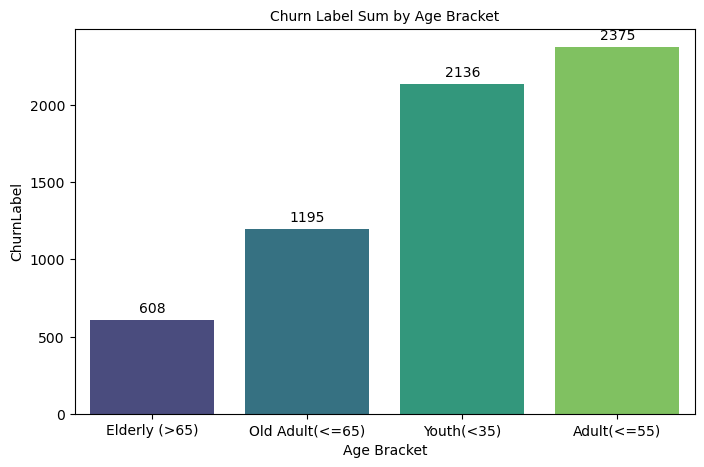

In [23]:
# Sort the DataFrame by 'ChurnLabel' in ascending order
agebrack_df = agebrack_df.sort_values(by='ChurnLabel')

plt.figure(figsize=(8,5))
# Plotting with Seaborn barplot
ax = sns.barplot(x='age_bracket', y='ChurnLabel', data=agebrack_df, palette='viridis')

# Adding numbers on top of the bars
for p, value in zip(ax.patches, agebrack_df['ChurnLabel']):
    plt.text(p.get_x() + p.get_width() / 2., p.get_height() + 30, f'{value}', ha='center', va='bottom')

# Adding labels and title
plt.title('Churn Label Sum by Age Bracket', fontsize=10)
plt.xlabel('Age Bracket')
plt.ylabel('ChurnLabel')

# Display the plot
plt.show()

#### The highest churn count is observed in the 'Adult(<=55)' age bracket with 2375 churn instances.The 'Youth(<35)' age bracket also shows a substantial churn count of 2136. These 2 category in our our countplot above are more in our data and then also have high numer of churn which signifies a potential challenge in retaining young customers.

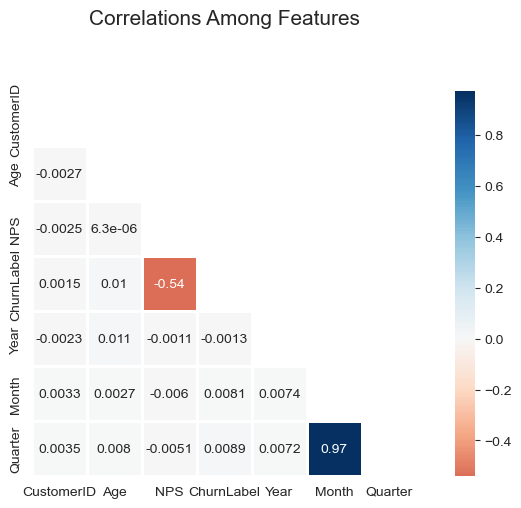

In [24]:
# Correlation Analysis
## heatmeap to see the correlation between features. 
# Generate a mask for the upper triangle
mask = np.zeros_like(df.corr(), dtype=bool)
mask[np.triu_indices_from(mask)] = True
sns.set_style('whitegrid')
plt.subplots(figsize = (10,5))
sns.heatmap(df.corr(), 
            annot=True,
            mask = mask,
            cmap = 'RdBu',
            linewidths=.9, 
            linecolor='white',
            fmt='.2g',
            center = 0,
            square=True)
plt.title("Correlations Among Features", y = 1.03,fontsize = 15, pad = 40);

#### We can see that the NPS have a moderate negative correlation with ChurnLabel. No other feature have a good correlation with ChurnLabel

### Explore the Nested columns in the data

In [25]:
# Nested Columns
nested_columns = [
    'PurchaseHistory',
    'SubscriptionDetails',
    'ServiceInteractions',
    'PaymentHistory',
    'WebsiteUsage',
    'ClickstreamData',
    'EngagementMetrics',
    'Feedback',
    'MarketingCommunication'
]

# Print out te first value in each of the columns
w1, w2 = 25, 1000
for col in nested_columns:
    row = [col, df[col][0]]
    print('\n| {:<{w1}} | {:<{w2}} |'.format(*row, w1=w1, w2=w2))


| PurchaseHistory           | [{'Product': 'Frozen Cocktail Mixes', 'Frequency': 8, 'Value': 884.43}, {'Product': 'Printer, Copier & Fax Machine Accessories', 'Frequency': 7, 'Value': 397.14}, {'Product': 'Hockey Stick Care', 'Frequency': 10, 'Value': 498.92}, {'Product': 'Guacamole', 'Frequency': 2, 'Value': 718.43}, {'Product': 'Mortisers', 'Frequency': 2, 'Value': 614.08}, {'Product': 'Rulers', 'Frequency': 6, 'Value': 221.68}, {'Product': 'Invitations', 'Frequency': 3, 'Value': 660.04}]                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                        

In [26]:
# We have to check if there are any pattern between customer feedback rating affects the churn

#Extracting rating from the feedback column and creating a new column for it
df['FeedbackRating'] = df['Feedback'].apply(lambda x: eval(x)['Rating'])


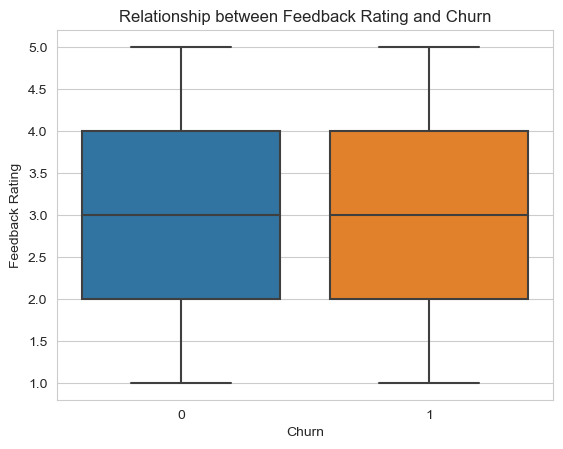

In [27]:
# Plotting the relationship between feedback rating and churn
sns.boxplot(x='ChurnLabel', y='FeedbackRating', data=df)
plt.title('Relationship between Feedback Rating and Churn')
plt.xlabel('Churn')
plt.ylabel('Feedback Rating')
plt.show()


#### There are no differences in the data for the churn and no churn in relation to the feedback rating 

### Data Preprocessing and Feature Engineering
- Create new features
- Data encoding to convert categorical features to numerircal
- Data scalling or normalisation
- Data splitting into train & test split for machine learning and predictie analytics
- Drop features not needed

- We can commence this by converting nested columns from strings formats to list/dictionaries using literal_eval function

In [28]:
from ast import literal_eval

# List the nested columns
nested_columns = [
    'PurchaseHistory',
    'SubscriptionDetails',
    'ServiceInteractions',
    'PaymentHistory',
    'WebsiteUsage',
    'ClickstreamData',
    'EngagementMetrics',
    'Feedback',
    'MarketingCommunication'
]

# Apply the Literal eval function

for feature in nested_columns:
    df[feature] = df[feature].apply(literal_eval)

In [29]:
# PurchaseHistory
df['PurchasedProducts'] = df['PurchaseHistory'].apply(lambda x: '|'.join(i['Product'] for i in x))
df['PurchasedFrequency'] = df['PurchaseHistory'].apply(lambda x: sum ([i['Frequency'] for i in x]))
df['PurchaseValue'] = df['PurchaseHistory'].apply(lambda x: sum ([i['Value'] for i in x]))

# SubscriptionDetails
df['SubscriptionPlan'] = df['SubscriptionDetails'].apply(lambda x: x['Plan'])
df['SubscriptionStartDate'] = df['SubscriptionDetails'].apply(lambda x: x['Start_Date'])
df['SubscriptionEndDate'] = df['SubscriptionDetails'].apply(lambda x: x['End_Date'])
df['SubscriptionDuration'] = (pd.to_datetime(df['SubscriptionEndDate']) - pd.to_datetime(df['SubscriptionStartDate'])).dt.days

# WebsiteUsage
df['WebsitepageViews'] = df['WebsiteUsage'].apply(lambda x: x['PageViews'])
df['WebsiteTimeSpent'] = df['WebsiteUsage'].apply(lambda x: x['TimeSpent(minutes)'])

# EngagementMetrics
df['EngagementMetricsLogins'] = df['EngagementMetrics'].apply(lambda x: x['Logins'])
df['EngagementMetricsFrequency'] = df['EngagementMetrics'].apply(lambda x: x['Frequency'])

# Feedback
df['FeedbackRating'] = df['Feedback'].apply(lambda x: x['Rating'])
df['FeedbackComment'] = df['Feedback'].apply(lambda x: x['Comment'])

# MarkettingCommunication
df['MarketingCommunicationNoOfEmmails'] = df['MarketingCommunication'].apply(lambda x: len(x))
df['MarketingCommunicationOpenClickDiff'] = df['MarketingCommunication'].apply(
    lambda x: np.mean([(pd.to_datetime(i['Email_Clicked']) \
                       - pd.to_datetime(i['Email_Opened'])).days for i in x
    ])
)
df['MarketingCommunicationSentOpenDiff'] = df['MarketingCommunication'].apply(
    lambda x: np.mean([
        (pd.to_datetime(i['Email_Opened']) - pd.to_datetime(i['Email_Sent'])).days for i in x
    ])
)


#### Special extraction from three Columns
- ServiceInteractions
- PaymentHistory
- ClickstreamData

- Check for unique parameters in these columns

In [30]:
# Service Interaction Types
service_interaction_types = df['ServiceInteractions'].apply(lambda x: list(set([i['Type'] for i in x])))
service_interaction_types = service_interaction_types.to_list()
unique_service_interaction_type = []
for i in service_interaction_types:
    unique_service_interaction_type.extend(i)
unique_service_interaction_type = list(set(unique_service_interaction_type))
print('All unique Service Interaction Types:', unique_service_interaction_type)

# Get All Unique PaymentHistory Method
payment_history_methods = df['PaymentHistory'].apply(lambda x: list(set([i['Method'] for i in x])))
payment_history_methods = payment_history_methods.to_list()
unique_payment_history_methods = []
for i in payment_history_methods:
    unique_payment_history_methods.extend(i)
unique_payment_history_methods = list(set(unique_payment_history_methods))
print('All unique Payment History Methods:',unique_payment_history_methods)

# Get all unique ClickstreamData Action
clickstream_data_actions = df['ClickstreamData'].apply(lambda x: list(set([i['Action'] for i in x])))
clickstream_data_actions = clickstream_data_actions.to_list()
unique_clickstream_data_actions = []
for i in clickstream_data_actions:
    unique_clickstream_data_actions.extend(i)
unique_clickstream_data_actions = list(set(unique_clickstream_data_actions))
print('All unique Clickstreat Data Actions:',unique_clickstream_data_actions)
    

All unique Service Interaction Types: ['Chat', 'Call', 'Email']
All unique Payment History Methods: ['Bank Transfer', 'Credit Card', 'PayPal']
All unique Clickstreat Data Actions: ['Search', 'Click', 'Add to Cart']


In [31]:
# Creating Features for ServiceInteractions
for usit in unique_service_interaction_type:
    df[f'ServiceInteractions_{usit}'] = df['ServiceInteractions'].apply(lambda x: len([i for i in x if i['Type'] == usit]))
    

# For Payment History
df['PaymentHistoryNoOfLatePayment'] = df['PaymentHistory'].apply(lambda x: sum(i['Late_Payments'] for i in x))
df['PaymentHistoryAvgNoOfLatePayments'] = df['PaymentHistory'].apply(lambda x: np.mean([i['Late_Payments'] for i in x]))


# ClickStream Data
for ucda in unique_clickstream_data_actions:
    df[f'ClickStreamData_{ucda}'] = df['ClickstreamData'].apply(lambda x: len([i for i in x if i['Action'] == ucda]))
     

In [32]:
# lets see the data extracted
df.head(2)

,CustomerID,Name,Age,Gender,Location,Email,Phone,Address,Segment,PurchaseHistory,...,MarketingCommunicationOpenClickDiff,MarketingCommunicationSentOpenDiff,ServiceInteractions_Chat,ServiceInteractions_Call,ServiceInteractions_Email,PaymentHistoryNoOfLatePayment,PaymentHistoryAvgNoOfLatePayments,ClickStreamData_Search,ClickStreamData_Click,ClickStreamData_Add to Cart
0,1001,Mark Barrett,31,Male,Andrewfort,allison74@example.net,3192528777,"61234 Shelley Heights Suite 467\nCohentown, GU...",Segment B,"[{'Product': 'Frozen Cocktail Mixes', 'Frequen...",...,319.0,818.0,2,1,1,40,13.333333,12,4,8
1,1002,Jeremy Welch,66,Female,Millerhaven,fmiller@example.com,231-587-1818x8651,"4959 Jennifer Junction\nNew Angelaport, TN 87397",Segment C,"[{'Product': 'Watercraft Polishes', 'Frequency...",...,88.0,110.0,4,5,10,10,3.333333,7,9,8


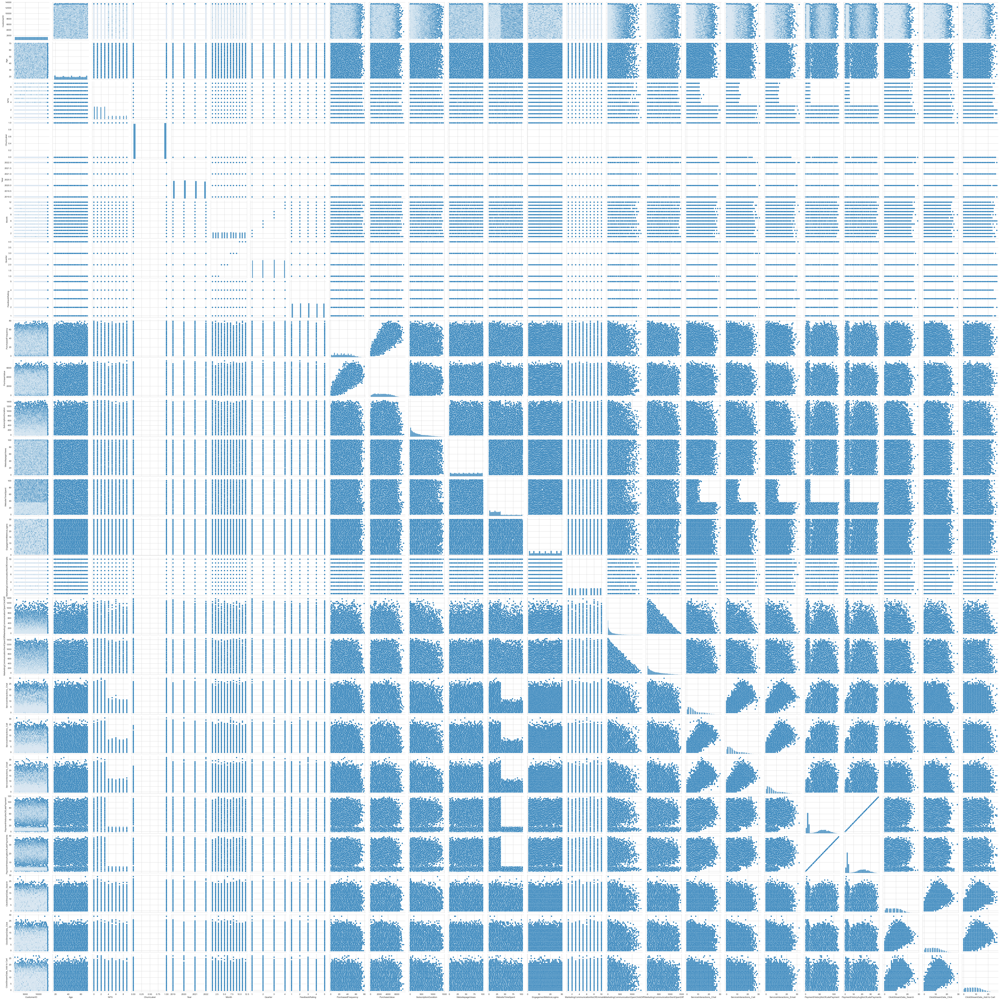

In [33]:
# Pairplot of the Numerical Variables
sns.pairplot(df, size=2.5);

In [34]:
df.columns

Index(['CustomerID', 'Name', 'Age', 'Gender', 'Location', 'Email', 'Phone',
       'Address', 'Segment', 'PurchaseHistory', 'SubscriptionDetails',
       'ServiceInteractions', 'PaymentHistory', 'WebsiteUsage',
       'ClickstreamData', 'EngagementMetrics', 'Feedback',
       'MarketingCommunication', 'NPS', 'ChurnLabel', 'Timestamp', 'Year',
       'Month', 'Month_name', 'Day_name', 'Quarter', 'Season', 'age_bracket',
       'FeedbackRating', 'PurchasedProducts', 'PurchasedFrequency',
       'PurchaseValue', 'SubscriptionPlan', 'SubscriptionStartDate',
       'SubscriptionEndDate', 'SubscriptionDuration', 'WebsitepageViews',
       'WebsiteTimeSpent', 'EngagementMetricsLogins',
       'EngagementMetricsFrequency', 'FeedbackComment',
       'MarketingCommunicationNoOfEmmails',
       'MarketingCommunicationOpenClickDiff',
       'MarketingCommunicationSentOpenDiff', 'ServiceInteractions_Chat',
       'ServiceInteractions_Call', 'ServiceInteractions_Email',
       'PaymentHistoryNoOfLat

In [35]:
# Select some columns for ML and Model Training
df1 = df[['Age', 'Gender', 'NPS', 'ChurnLabel', 'PurchasedFrequency',
       'PurchaseValue', 'SubscriptionPlan', 'WebsitepageViews',
       'WebsiteTimeSpent', 'EngagementMetricsLogins',
       'EngagementMetricsFrequency', 'FeedbackRating',
       'MarketingCommunicationNoOfEmmails',
       'MarketingCommunicationOpenClickDiff',
       'MarketingCommunicationSentOpenDiff', 'ServiceInteractions_Chat',
       'ServiceInteractions_Email', 'ServiceInteractions_Call',
       'PaymentHistoryNoOfLatePayment','SubscriptionDuration',
       'ClickStreamData_Add to Cart', 'ClickStreamData_Search',
       'ClickStreamData_Click']]

In [36]:
# See the first 2 rows
df1.head(2)

,Age,Gender,NPS,ChurnLabel,PurchasedFrequency,PurchaseValue,SubscriptionPlan,WebsitepageViews,WebsiteTimeSpent,EngagementMetricsLogins,...,MarketingCommunicationOpenClickDiff,MarketingCommunicationSentOpenDiff,ServiceInteractions_Chat,ServiceInteractions_Email,ServiceInteractions_Call,PaymentHistoryNoOfLatePayment,SubscriptionDuration,ClickStreamData_Add to Cart,ClickStreamData_Search,ClickStreamData_Click
0,31,Male,3,1,38,3994.72,Express,49,15,19,...,319.0,818.0,2,1,1,40,871,8,12,4
1,66,Female,6,0,4,2844.35,Pro,100,9,9,...,88.0,110.0,4,10,5,10,290,8,7,9


In [37]:
# We still have some items as objects which we need to encode for ML
df1.loc[0]

Age                                         31
Gender                                    Male
NPS                                          3
ChurnLabel                                   1
PurchasedFrequency                          38
PurchaseValue                          3994.72
SubscriptionPlan                       Express
WebsitepageViews                            49
WebsiteTimeSpent                            15
EngagementMetricsLogins                     19
EngagementMetricsFrequency              Weekly
FeedbackRating                               1
MarketingCommunicationNoOfEmmails            8
MarketingCommunicationOpenClickDiff      319.0
MarketingCommunicationSentOpenDiff       818.0
ServiceInteractions_Chat                     2
ServiceInteractions_Email                    1
ServiceInteractions_Call                     1
PaymentHistoryNoOfLatePayment               40
SubscriptionDuration                       871
ClickStreamData_Add to Cart                  8
ClickStreamDa

In [38]:
# lets drop the Y from the data
y = df1['ChurnLabel']

In [39]:
# lets Call the Predictors out, excluding the ChurnLabel, which is our target
X = df1[['Age', 'Gender', 'NPS', 'PurchasedFrequency',
       'PurchaseValue', 'SubscriptionPlan', 'WebsitepageViews',
       'WebsiteTimeSpent', 'EngagementMetricsLogins',
       'EngagementMetricsFrequency', 'FeedbackRating',
       'MarketingCommunicationNoOfEmmails',
       'MarketingCommunicationOpenClickDiff',
       'MarketingCommunicationSentOpenDiff', 'ServiceInteractions_Chat',
       'ServiceInteractions_Email', 'ServiceInteractions_Call',
       'PaymentHistoryNoOfLatePayment', 'SubscriptionDuration',
       'ClickStreamData_Add to Cart', 'ClickStreamData_Search',
       'ClickStreamData_Click']]

In [40]:
X.head(2)

,Age,Gender,NPS,PurchasedFrequency,PurchaseValue,SubscriptionPlan,WebsitepageViews,WebsiteTimeSpent,EngagementMetricsLogins,EngagementMetricsFrequency,...,MarketingCommunicationOpenClickDiff,MarketingCommunicationSentOpenDiff,ServiceInteractions_Chat,ServiceInteractions_Email,ServiceInteractions_Call,PaymentHistoryNoOfLatePayment,SubscriptionDuration,ClickStreamData_Add to Cart,ClickStreamData_Search,ClickStreamData_Click
0,31,Male,3,38,3994.72,Express,49,15,19,Weekly,...,319.0,818.0,2,1,1,40,871,8,12,4
1,66,Female,6,4,2844.35,Pro,100,9,9,Weekly,...,88.0,110.0,4,10,5,10,290,8,7,9


In [41]:
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
# label Encoding of the Independent Variables
encoder = LabelEncoder() # method initialisation

# Looping for columns
for x in X.columns[1:]:
    if(X[x].dtype=='object'):
        X[x] = encoder.fit_transform(X[x])
    else:
        X[x] = X[x]
X.head(2)

,Age,Gender,NPS,PurchasedFrequency,PurchaseValue,SubscriptionPlan,WebsitepageViews,WebsiteTimeSpent,EngagementMetricsLogins,EngagementMetricsFrequency,...,MarketingCommunicationOpenClickDiff,MarketingCommunicationSentOpenDiff,ServiceInteractions_Chat,ServiceInteractions_Email,ServiceInteractions_Call,PaymentHistoryNoOfLatePayment,SubscriptionDuration,ClickStreamData_Add to Cart,ClickStreamData_Search,ClickStreamData_Click
0,31,1,3,38,3994.72,6,49,15,19,2,...,319.0,818.0,2,1,1,40,871,8,12,4
1,66,0,6,4,2844.35,12,100,9,9,2,...,88.0,110.0,4,10,5,10,290,8,7,9


#### Split Data into Train Test 

In [42]:
# Split the data into training and testing sets
from sklearn.model_selection import train_test_split
# Split the data into train and temp sets (80% train, 20% temp)

X_train, X_test_temp, y_train, y_test_temp = train_test_split(X, y, test_size=0.3,  random_state=42)

print(X_train.shape)
print(X_test_temp.shape)
print(y_train.shape)
print(y_test_temp.shape)

(8738, 22)
(3745, 22)
(8738,)
(3745,)


In [43]:
# Split the temp set into validation and test sets (50% validation, 50% test)
X_val, X_test, y_val, y_test = train_test_split(X_test_temp, y_test_temp, test_size=0.5, random_state=42)

print(X_val.shape)
print(X_test.shape)
print(y_val.shape)
print(y_test.shape)

(1872, 22)
(1873, 22)
(1872,)
(1873,)


In [44]:
# Scale the features using RobustScaler on the training, validation and testing set
scaler = RobustScaler()
# Fit and transform on the training set
X_train = scaler.fit_transform(X_train)

# Transform the validation set using the parameters learned from the training set
X_val = scaler.transform(X_val)

# Transform the test set using the parameters learned from the training set
X_test = scaler.transform(X_test)

### Build the Model
- Logistic Regression
- Random Forest Classifier

### Evaluation Metrics
- Accuracy, Precision, Recall & F1Score

In [45]:
from sklearn.linear_model import SGDClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
# Evaluation Metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from sklearn.metrics import confusion_matrix

In [46]:
rf = RandomForestClassifier()

rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)

print(classification_report(y_test, y_pred))
print('=='*20)
print('ROC-AUC:', roc_auc_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.97      0.98      0.97       928
           1       0.98      0.97      0.97       945

    accuracy                           0.97      1873
   macro avg       0.97      0.97      0.97      1873
weighted avg       0.97      0.97      0.97      1873

ROC-AUC: 0.973889915161467


In [47]:
# using Logistic Regression
lr = LogisticRegression()
lr.fit(X_train, y_train)

# Evaluation
y_pred = lr.predict(X_test)

print(classification_report(y_test, y_pred))
print('=='*20)
print('ROC-AUC:', roc_auc_score(y_test, y_pred))



              precision    recall  f1-score   support

           0       0.96      0.98      0.97       928
           1       0.98      0.96      0.97       945

    accuracy                           0.97      1873
   macro avg       0.97      0.97      0.97      1873
weighted avg       0.97      0.97      0.97      1873

ROC-AUC: 0.9707153119868638


In [48]:
# Model Evaluation on Unseen Data
# Random Forest Evaluation

y_val_pred = rf.predict(X_val)
val_accuracy = accuracy_score(y_val, y_val_pred)
val_precision = precision_score(y_val, y_val_pred)
val_f1score = f1_score(y_val, y_val_pred)
val_recall = recall_score(y_val, y_val_pred)

print('Random Forest Validation')
print('Accuracy:', f'{val_accuracy:.2f}')
print('Precision:', f'{val_precision:.2f}')
print('F1score:', f'{val_f1score:.2f}')
print('Recall:', f'{val_recall:.2f}')

Random Forest Validation
Accuracy: 0.97
Precision: 0.96
F1score: 0.97
Recall: 0.98


In [49]:
# Logistic Regression Evaluation
y_val_pred1 = lr.predict(X_val)
val_accuracy = accuracy_score(y_val, y_val_pred1)
val_precision = precision_score(y_val, y_val_pred1)
val_F1score = f1_score(y_val, y_val_pred1)
val_recall = recall_score(y_val, y_val_pred1)


print('Logistic Regression Validation')
print('Accuracy:', f'{val_accuracy:.2f}')
print('Precision:', f'{val_precision:.2f}')
print('F1score:', f'{val_f1score:.2f}')
print('Recall:', f'{val_recall:.2f}')

Logistic Regression Validation
Accuracy: 0.96
Precision: 0.96
F1score: 0.97
Recall: 0.96


Classifier: Random Forest


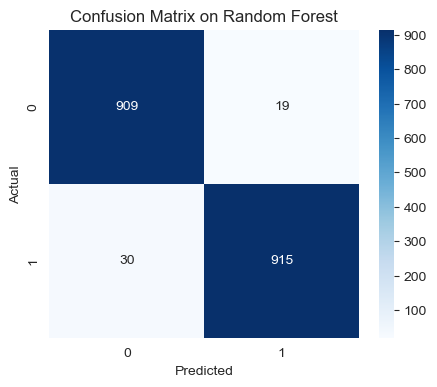

In [54]:
# Print Confusion matrix
    
# Predict on the test set
y_pred_rf = rf.predict(X_test)
    
# Print the classifier's name
print("Classifier: Random Forest")
       
# Create Confusion Matrix
cm = confusion_matrix(y_test,  y_pred_rf)

# Plotting the confusion matrix with colors
plt.figure(figsize=(5, 4))
sns.heatmap(cm, annot=True, cmap="Blues", fmt="d", xticklabels=['0','1'], yticklabels=['0','1'])
plt.title("Confusion Matrix on Random Forest")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Classifier: Logistic Regression


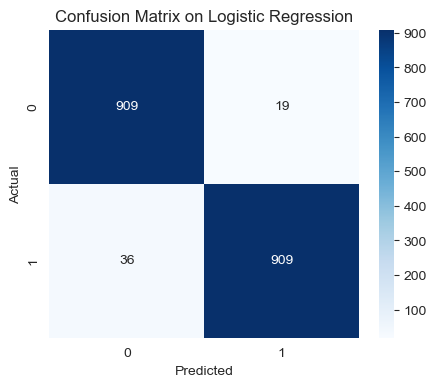

In [55]:
# Print Confusion matrix
    
# Predict on the test set
y_pred_log = lr.predict(X_test)
    
# Print the classifier's name
print("Classifier: Logistic Regression")
       
# Create Confusion Matrix
cm = confusion_matrix(y_test,  y_pred_log)

# Plotting the confusion matrix with colors
plt.figure(figsize=(5, 4))
sns.heatmap(cm, annot=True, cmap="Blues", fmt="d", xticklabels=['0','1'], yticklabels=['0','1'])
plt.title("Confusion Matrix on Logistic Regression")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()